In [1]:
import os

dataset_path = "/kaggle/input/rsna-bone-age"

for item in os.listdir(dataset_path):
    print(item)


RSNA_val
RSNA_Annotations
RSNA_test
RSNA_train


In [2]:
annotations_path = os.path.join(dataset_path, "RSNA_Annotations")
print(os.listdir(annotations_path))

annotations_path = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations"
print(os.listdir(annotations_path))



['RSNA_Annotations']
['BONEAGE', 'ANATOMICAL_ROIS']


In [3]:
import pandas as pd

train_csv = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_train.csv"
df_train = pd.read_csv(train_csv)
print(df_train.head())


     ID   Male  Boneage
0  1377  False      180
1  1378  False       12
2  1379  False       94
3  1380   True      120
4  1381  False       82


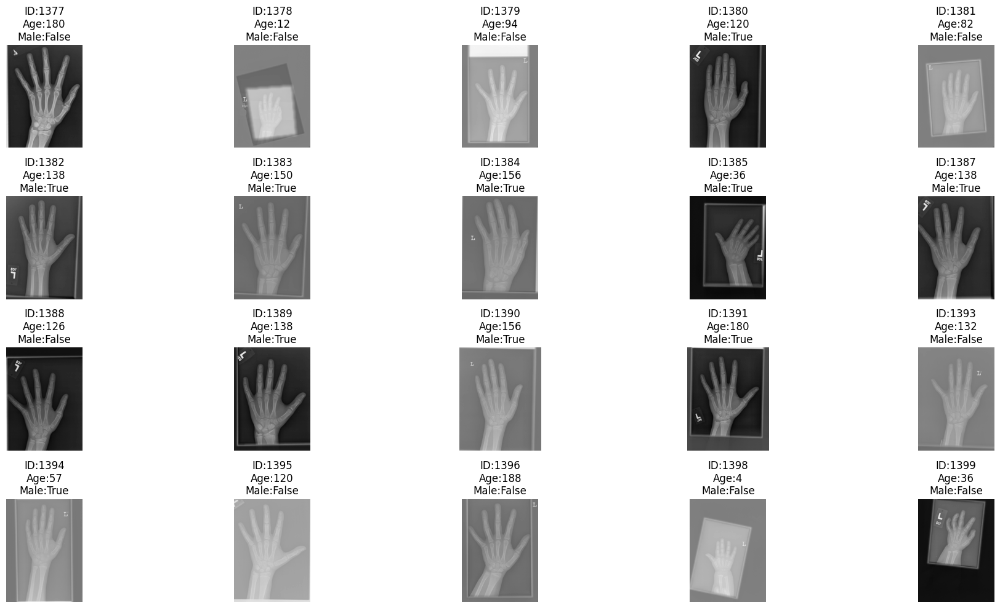

In [4]:
import matplotlib.pyplot as plt
from PIL import Image


train_images_path = "/kaggle/input/rsna-bone-age/RSNA_train/images"

num_images = 20
plt.figure(figsize=(20, 10))

for i in range(num_images):
    img_id = str(df_train.loc[i, "ID"])
    boneage = df_train.loc[i, "Boneage"]
    male = df_train.loc[i, "Male"]
    
    img_path = os.path.join(train_images_path, f"{img_id}.png")
    img = Image.open(img_path).convert("L")  # convert to grayscale
    
    plt.subplot(4, 5, i+1)
    plt.imshow(img, cmap="gray")
    plt.title(f"ID:{img_id}\nAge:{boneage}\nMale:{male}")
    plt.axis("off")

plt.tight_layout()
plt.show()


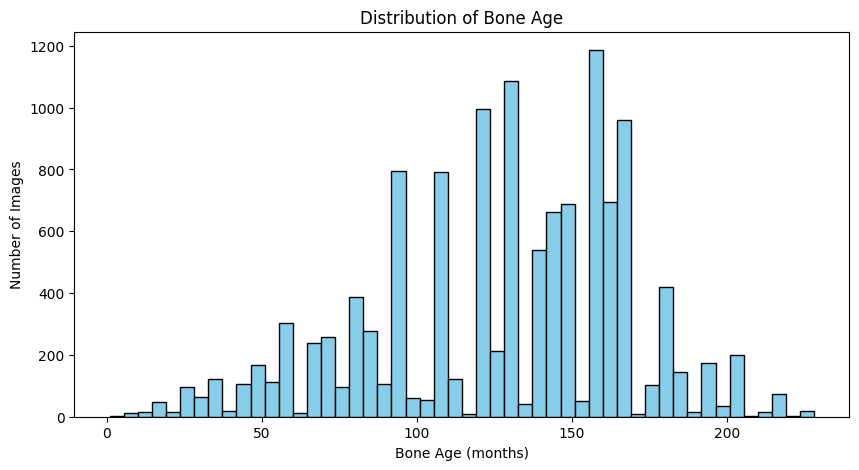

In [5]:
plt.figure(figsize=(10,5))
plt.hist(df_train['Boneage'], bins=50, color='skyblue', edgecolor='black')
plt.title("Distribution of Bone Age")
plt.xlabel("Bone Age (months)")
plt.ylabel("Number of Images")
plt.show()


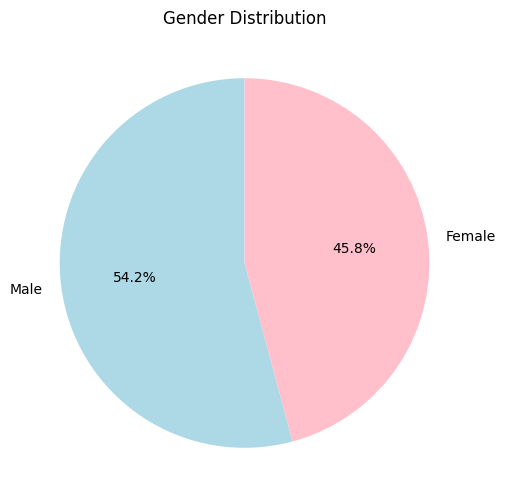

In [6]:


gender_counts = df_train['Male'].value_counts() 
labels = ['Male', 'Female']  
sizes = [gender_counts[True], gender_counts[False]]

plt.figure(figsize=(6,6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=['lightblue', 'pink'], startangle=90)
plt.title("Gender Distribution")
plt.show()


In [7]:
import shutil
import os

src_train = "/kaggle/input/rsna-bone-age/RSNA_train/images"
src_val   = "/kaggle/input/rsna-bone-age/RSNA_val/images"
src_test  = "/kaggle/input/rsna-bone-age/RSNA_test/images"

dst_train = "/kaggle/working/train"
dst_val   = "/kaggle/working/val"
dst_test  = "/kaggle/working/test"

os.makedirs(dst_train, exist_ok=True)
os.makedirs(dst_val, exist_ok=True)
os.makedirs(dst_test, exist_ok=True)

def copy_if_needed(src, dst):
    for f in os.listdir(src):
        if f.endswith(".png"):
            shutil.copy(os.path.join(src, f), os.path.join(dst, f))

copy_if_needed(src_train, dst_train)
copy_if_needed(src_val, dst_val)
copy_if_needed(src_test, dst_test)

print("✔ Images copied to working directory.")


✔ Images copied to working directory.


In [8]:
import os

train_dir = "/kaggle/working/train"
val_dir   = "/kaggle/working/val"
test_dir  = "/kaggle/working/test"

def count_images(path):
    return len([f for f in os.listdir(path) if f.endswith((".png", ".jpg", ".jpeg"))])

train_count = count_images(train_dir)
val_count   = count_images(val_dir)
test_count  = count_images(test_dir)

print("📌 Dataset Summary:")
print("-------------------------")
print("Train images:", train_count)
print("Val images:  ", val_count)
print("Test images: ", test_count)
print("-------------------------")
print("Total images:", train_count + val_count + test_count)


📌 Dataset Summary:
-------------------------
Train images: 12611
Val images:   1425
Test images:  200
-------------------------
Total images: 14236


In [9]:
import os

train_dir = "/kaggle/working/train"
val_dir   = "/kaggle/working/val"
test_dir  = "/kaggle/working/test"

masks_dir = "/kaggle/input/rsna-bone-age-masks/Tensormask"

# ------------------------------------------------
# FUNCTION TO CHECK MISSING MASKS
# ------------------------------------------------
def check_missing(split_dir, masks_dir):
    images = [f for f in os.listdir(split_dir) if f.endswith((".png", ".jpg", ".jpeg"))]
    masks  = [f for f in os.listdir(masks_dir) if f.endswith((".png", ".jpg"))]

    mask_names = {os.path.splitext(f)[0] for f in masks}

    missing = []
    for img in images:
        img_name = os.path.splitext(img)[0]
        if img_name not in mask_names:
            missing.append(img)

    return missing

# ------------------------------------------------
# FUNCTION TO DELETE IMAGES WITHOUT MASKS
# ------------------------------------------------
def delete_missing(split_dir, missing_list):
    deleted = 0
    for img in missing_list:
        full_path = os.path.join(split_dir, img)
        if os.path.exists(full_path):
            os.remove(full_path)
            deleted += 1
    return deleted


# ------------------------------------------------
# STEP 1 — FIND MISSING IMAGES
# ------------------------------------------------
print("Checking for missing masks...")

miss_train = check_missing(train_dir, masks_dir)
miss_val   = check_missing(val_dir, masks_dir)
miss_test  = check_missing(test_dir, masks_dir)

print("\nBefore deletion:")
print("Train missing:", len(miss_train))
print("Val missing:",   len(miss_val))
print("Test missing:",  len(miss_test))


# ------------------------------------------------
# STEP 2 — DELETE THEM
# ------------------------------------------------
print("\nDeleting missing images...")

del_train = delete_missing(train_dir, miss_train)
del_val   = delete_missing(val_dir, miss_val)
del_test  = delete_missing(test_dir, miss_test)

print("Deleted from train:", del_train)
print("Deleted from val:",   del_val)
print("Deleted from test:",  del_test)


# ------------------------------------------------
# STEP 3 — RECHECK AFTER DELETION
# ------------------------------------------------
print("\nRechecking...")

miss_train_after = check_missing(train_dir, masks_dir)
miss_val_after   = check_missing(val_dir, masks_dir)
miss_test_after  = check_missing(test_dir, masks_dir)

print("\nAfter deletion:")
print("Train missing:", len(miss_train_after))
print("Val missing:",   len(miss_val_after))
print("Test missing:",  len(miss_test_after))


Checking for missing masks...

Before deletion:
Train missing: 27
Val missing: 2
Test missing: 0

Deleting missing images...
Deleted from train: 27
Deleted from val: 2
Deleted from test: 0

Rechecking...

After deletion:
Train missing: 0
Val missing: 0
Test missing: 0


In [10]:
import os

train_dir = "/kaggle/working/train"
val_dir   = "/kaggle/working/val"
test_dir  = "/kaggle/working/test"

def count_images(path):
    return len([f for f in os.listdir(path) if f.endswith((".png", ".jpg", ".jpeg"))])

train_count = count_images(train_dir)
val_count   = count_images(val_dir)
test_count  = count_images(test_dir)

print("📌 Dataset Summary:")
print("-------------------------")
print("Train images:", train_count)
print("Val images:  ", val_count)
print("Test images: ", test_count)
print("-------------------------")
print("Total images:", train_count + val_count + test_count)


📌 Dataset Summary:
-------------------------
Train images: 12584
Val images:   1423
Test images:  200
-------------------------
Total images: 14207


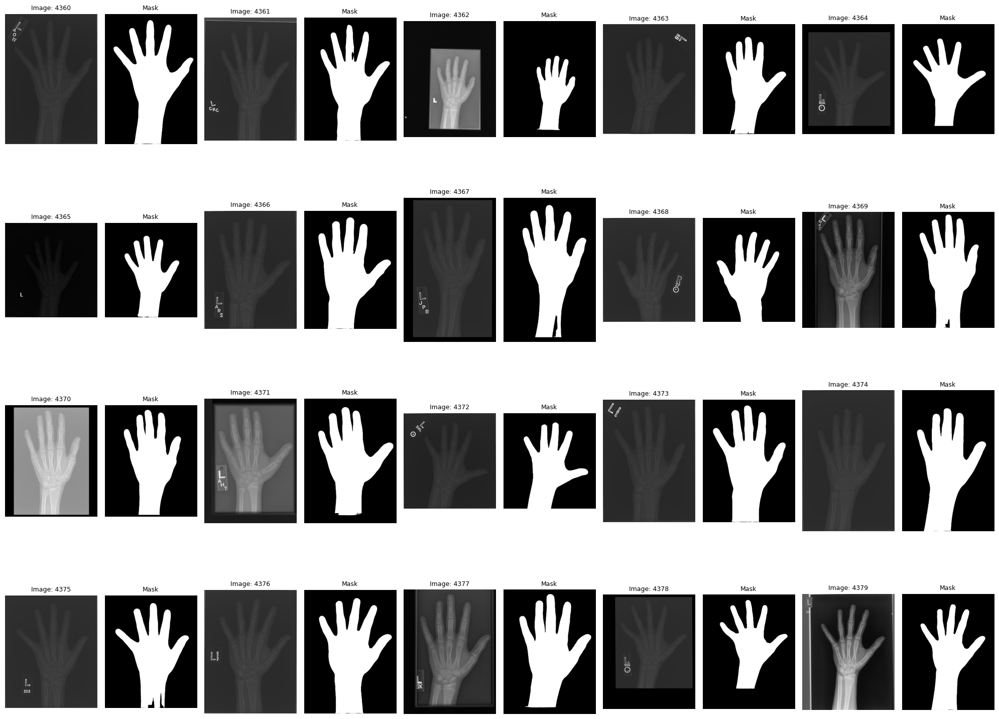

In [11]:

import os
import cv2
import matplotlib.pyplot as plt

# Paths
RAW_IMAGES_PATH = "/kaggle/working/test"
MASKS_PATH = "/kaggle/input/rsna-bone-age-masks/Tensormask"

# Get list of image IDs shared between images & masks
image_files = sorted([f.replace(".png", "") for f in os.listdir(RAW_IMAGES_PATH) if f.endswith(".png")])
mask_files  = sorted([f.replace(".png", "") for f in os.listdir(MASKS_PATH) if f.endswith(".png")])

available_pairs = list(set(image_files) & set(mask_files))
available_pairs = sorted(available_pairs)[:20]  # أول 10 بس

# Visualization
if len(available_pairs) > 0:

    N_IMAGES_PER_ROW = 5
    N_COLS = N_IMAGES_PER_ROW * 2   # صورة + ماسك
    N_ROWS = (len(available_pairs) + N_IMAGES_PER_ROW - 1) // N_IMAGES_PER_ROW

    fig, axes = plt.subplots(N_ROWS, N_COLS, figsize=(20, N_ROWS * 4))
    axes = axes.flatten()

    for i, image_id in enumerate(available_pairs):

        ax_img = i * 2
        ax_mask = i * 2 + 1

        img_path = os.path.join(RAW_IMAGES_PATH, f"{image_id}.png")
        mask_path = os.path.join(MASKS_PATH, f"{image_id}.png")

        try:
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

            # Original image
            axes[ax_img].imshow(img)
            axes[ax_img].set_title(f"Image: {image_id}", fontsize=9)
            axes[ax_img].axis('off')

            # Mask
            axes[ax_mask].imshow(mask, cmap='gray')
            axes[ax_mask].set_title("Mask", fontsize=9)
            axes[ax_mask].axis('off')

        except Exception as e:
            axes[ax_img].axis('off')
            axes[ax_mask].axis('off')

    # Hide empty axes
    for j in range(len(available_pairs) * 2, N_ROWS * N_COLS):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

else:
    print("No matching image/mask pairs found!")



In [12]:
import os
import cv2
from tqdm import tqdm

# Paths
RAW_IMAGES_PATHS = {
    'train': "/kaggle/working/train",
    'val':   "/kaggle/working/val",
    'test':  "/kaggle/working/test"
}
MASKS_PATH = "/kaggle/input/rsna-bone-age-masks/Tensormask"
OUTPUT_PATH = "/kaggle/working/processed_images"

TARGET_SIZE = 512  # الحجم النهائي لكل الصور

# إنشاء مجلدات الخرج لو مش موجودة
for split in RAW_IMAGES_PATHS:
    os.makedirs(os.path.join(OUTPUT_PATH, split), exist_ok=True)

def apply_mask(img_path, mask_path, target_size=TARGET_SIZE):
    """تطبق الماسك وتعمل resize"""
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    
    if img is None or mask is None:
        return None
    
    mask[mask > 0] = 255
    masked_img = cv2.bitwise_and(img, img, mask=mask)
    
    # Crop to mask bounding box
    coords = cv2.findNonZero(mask)
    if coords is None:
        return None
    x, y, w, h = cv2.boundingRect(coords)
    cropped_img = masked_img[y:y+h, x:x+w]
    
    # Resize
    final_img = cv2.resize(cropped_img, (target_size, target_size))
    return final_img

# تنفيذ العملية على كل الـ splits
results = {}

for split, raw_dir in RAW_IMAGES_PATHS.items():
    print(f"\nProcessing {split} split...")
    images = [f for f in os.listdir(raw_dir) if f.endswith(".png")]
    processed_count = 0
    missing_masks = []

    for img_file in tqdm(images):
        img_id = os.path.splitext(img_file)[0]
        img_path = os.path.join(raw_dir, img_file)
        mask_path = os.path.join(MASKS_PATH, f"{img_id}.png")
        output_file = os.path.join(OUTPUT_PATH, split, img_file)
        
        if not os.path.exists(mask_path):
            missing_masks.append(img_file)
            continue
        
        processed_img = apply_mask(img_path, mask_path)
        if processed_img is not None:
            cv2.imwrite(output_file, processed_img)
            processed_count += 1
    
    results[split] = (processed_count, len(missing_masks))

# طباعة النتائج
print("\n---- RESULTS ----")
for split in results:
    processed, missing = results[split]
    print(f"{split.capitalize()} - Processed: {processed}, Missing masks: {missing}")



Processing train split...


100%|██████████| 12584/12584 [11:49<00:00, 17.73it/s]



Processing val split...


100%|██████████| 1423/1423 [01:19<00:00, 17.95it/s]



Processing test split...


100%|██████████| 200/200 [00:10<00:00, 19.38it/s]


---- RESULTS ----
Train - Processed: 12584, Missing masks: 0
Val - Processed: 1423, Missing masks: 0
Test - Processed: 200, Missing masks: 0


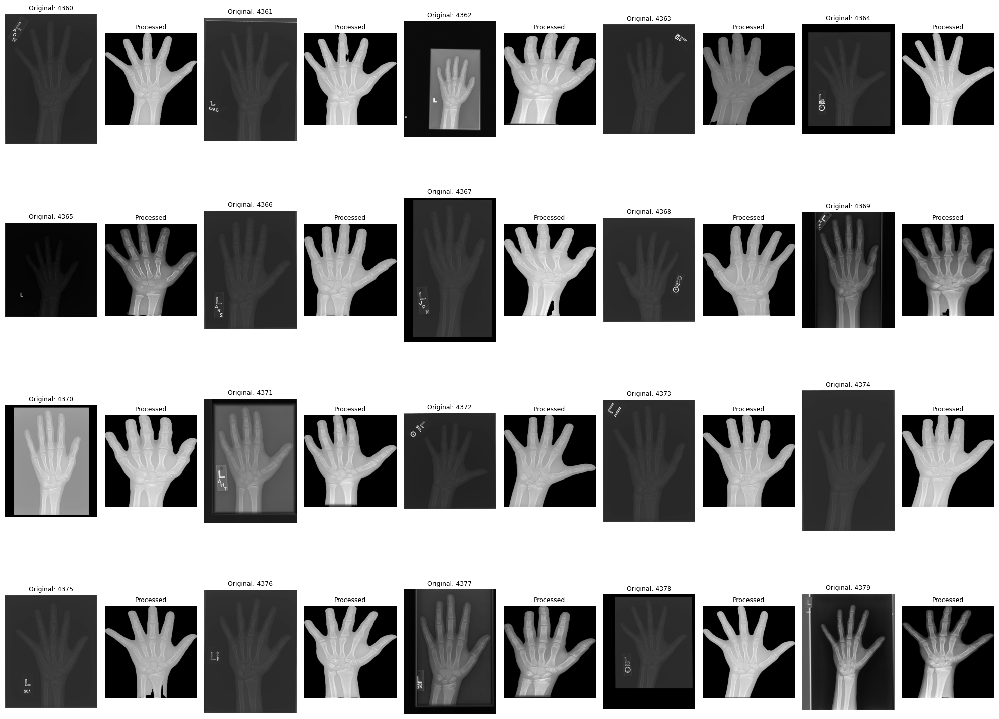

In [13]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

RAW_IMAGES_PATH = "/kaggle/working/test"  # الصور الأصلية
PROCESSED_IMAGES_PATH = "/kaggle/working/processed_images/test"  # الصور بعد الماسك/المعالجة

# Get common image IDs
raw_files = sorted([f.replace(".png","") for f in os.listdir(RAW_IMAGES_PATH) if f.endswith(".png")])
processed_files = sorted([f.replace(".png","") for f in os.listdir(PROCESSED_IMAGES_PATH) if f.endswith(".png")])
available_pairs = sorted(list(set(raw_files) & set(processed_files)))[:20]  # أول 20

if len(available_pairs) > 0:
    N_IMAGES_PER_ROW = 5
    N_COLS = N_IMAGES_PER_ROW * 2  # Original + Processed
    N_ROWS = (len(available_pairs) + N_IMAGES_PER_ROW - 1) // N_IMAGES_PER_ROW

    fig, axes = plt.subplots(N_ROWS, N_COLS, figsize=(20, N_ROWS * 4))
    axes = axes.flatten()

    for i, image_id in enumerate(available_pairs):
        ax_orig = i * 2
        ax_processed = i * 2 + 1

        try:
            # Original as grayscale
            img_orig = cv2.imread(os.path.join(RAW_IMAGES_PATH, f"{image_id}.png"), cv2.IMREAD_GRAYSCALE)

            # Processed as grayscale
            img_processed = cv2.imread(os.path.join(PROCESSED_IMAGES_PATH, f"{image_id}.png"), cv2.IMREAD_GRAYSCALE)

            axes[ax_orig].imshow(img_orig, cmap='gray')
            axes[ax_orig].set_title(f"Original: {image_id}", fontsize=9)
            axes[ax_orig].axis('off')

            axes[ax_processed].imshow(img_processed, cmap='gray')
            axes[ax_processed].set_title("Processed", fontsize=9)
            axes[ax_processed].axis('off')

        except:
            axes[ax_orig].axis('off')
            axes[ax_processed].axis('off')

    # Hide unused axes
    for j in range(len(available_pairs) * 2, N_ROWS * N_COLS):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("No matching images found!")


In [14]:
IMG_ID = "2338"
INPUT_DIR = "/kaggle/working/processed_images/val"
img_path = os.path.join(INPUT_DIR, f"{IMG_ID}.png")

if os.path.exists(img_path):
    os.remove(img_path)
    print(f"✅ Image {IMG_ID}.png has been deleted.")
else:
    print(f"❌ Image {IMG_ID}.png not found.")


✅ Image 2338.png has been deleted.


In [15]:
IMG_ID ="1908"
INPUT_DIR = "/kaggle/working/processed_images/val"
img_path = os.path.join(INPUT_DIR, f"{IMG_ID}.png")

if os.path.exists(img_path):
    os.remove(img_path)
    print(f"✅ Image {IMG_ID}.png has been deleted.")
else:
    print(f"❌ Image {IMG_ID}.png not found.")

✅ Image 1908.png has been deleted.


In [16]:
IMG_ID ="1583"
INPUT_DIR = "/kaggle/working/processed_images/val"
img_path = os.path.join(INPUT_DIR, f"{IMG_ID}.png")

if os.path.exists(img_path):
    os.remove(img_path)
    print(f"✅ Image {IMG_ID}.png has been deleted.")
else:
    print(f"❌ Image {IMG_ID}.png not found.")

✅ Image 1583.png has been deleted.


In [17]:
IMG_ID ="1603"
INPUT_DIR = "/kaggle/working/processed_images/val"
img_path = os.path.join(INPUT_DIR, f"{IMG_ID}.png")

if os.path.exists(img_path):
    os.remove(img_path)
    print(f"✅ Image {IMG_ID}.png has been deleted.")
else:
    print(f"❌ Image {IMG_ID}.png not found.")

✅ Image 1603.png has been deleted.


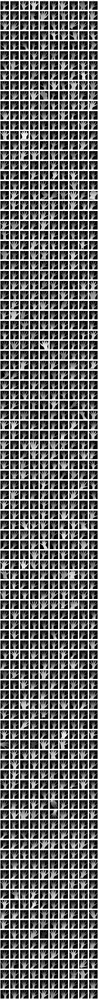

In [18]:
import cv2
import matplotlib.pyplot as plt
import os
import random

# مسار الصور
RAW_IMAGES_PATH = "/kaggle/working/processed_images/val"  # عدل حسب مكان الصور

# جلب كل الملفات
all_images = [f for f in os.listdir(RAW_IMAGES_PATH) if f.endswith(".png")]

# اختيار 100 صورة عشوائية
sample_images = random.sample(all_images, min(1000, len(all_images)))

# إعداد الشكل للعرض
N_IMAGES_PER_ROW = 10
N_ROWS = (len(sample_images) + N_IMAGES_PER_ROW - 1) // N_IMAGES_PER_ROW
fig, axes = plt.subplots(N_ROWS, N_IMAGES_PER_ROW, figsize=(20, N_ROWS*2))
axes = axes.flatten()

for i, img_file in enumerate(sample_images):
    img_path = os.path.join(RAW_IMAGES_PATH, img_file)
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)  # قراءة grayscale
    axes[i].imshow(img, cmap='gray')
    axes[i].axis('off')
    axes[i].set_title(img_file.replace(".png",""), fontsize=6)

# اخفاء أي محاور فاضية
for j in range(len(sample_images), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


In [19]:
import os
import cv2
import numpy as np

# Paths للصور المعالجة
PROCESSED_TRAIN_DIR = "/kaggle/working/processed_images/train"
PROCESSED_VAL_DIR   = "/kaggle/working/processed_images/val"
PROCESSED_TEST_DIR  = "/kaggle/working/processed_images/test"

# Paths للإخراج بعد normalization
OUTPUT_TRAIN_DIR = "/kaggle/working/normalized_processed_images/train"
OUTPUT_VAL_DIR   = "/kaggle/working/normalized_processed_images/val"
OUTPUT_TEST_DIR  = "/kaggle/working/normalized_processed_images/test"

# إنشاء المجلدات لو مش موجودة
for d in [OUTPUT_TRAIN_DIR, OUTPUT_VAL_DIR, OUTPUT_TEST_DIR]:
    os.makedirs(d, exist_ok=True)

def normalize_and_save(input_dir, output_dir):
    files = [f for f in os.listdir(input_dir) if f.endswith(".png")]
    for f in files:
        img_path = os.path.join(input_dir, f)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if img is None:
            print(f"⚠️  Could not read {img_path}")
            continue
        # z-score normalization
        img_norm = (img - img.mean()) / img.std()
        # scale to 0-255 for saving
        img_norm_disp = 255 * (img_norm - img_norm.min()) / (img_norm.max() - img_norm.min())
        img_norm_disp = img_norm_disp.astype(np.uint8)
        cv2.imwrite(os.path.join(output_dir, f), img_norm_disp)

# Apply normalization
normalize_and_save(PROCESSED_TRAIN_DIR, OUTPUT_TRAIN_DIR)
normalize_and_save(PROCESSED_VAL_DIR, OUTPUT_VAL_DIR)
normalize_and_save(PROCESSED_TEST_DIR, OUTPUT_TEST_DIR)

print("✅ Normalization applied to all processed images and saved.")


✅ Normalization applied to all processed images and saved.


In [20]:
import pandas as pd

# -----------------------------
# 1) قراءة البيانات
# -----------------------------
df = pd.read_csv("/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_train.csv")  # columns: 'image_path', 'age_months'

# -----------------------------
# 2) حساب عدد الصور لكل شهر
# -----------------------------
month_counts = df['Boneage'].value_counts().sort_index()  # sort من أقل لشهر أكبر

# -----------------------------
# 3) تحديد الهدف (أكبر عدد صور موجود لشهر واحد)
# -----------------------------
max_count = month_counts.max()

# -----------------------------
# 4) حساب عدد الأوجمنتيشن لكل شهر
# -----------------------------
augmentation_needed = max_count - month_counts
augmentation_needed = augmentation_needed.reset_index()
augmentation_needed.columns = ['age_months', 'augment_needed']

# ترتيب من أقل شهر لأكبر شهر
augmentation_needed = augmentation_needed.sort_values('age_months')

print(augmentation_needed)


     age_months  augment_needed
0             1            1112
1             4            1112
2             6            1111
3             9            1108
4            10            1109
..          ...             ...
155         212            1111
156         214            1112
157         216            1041
158         222            1111
159         228            1094

[160 rows x 2 columns]


In [21]:
import pandas as pd
import os

# CSV paths
train_csv = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_train.csv"
val_csv   = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_val.csv"

train_dir = "/kaggle/working/normalized_processed_images/train/"
val_dir   = "/kaggle/working/normalized_processed_images/val/"

# Load CSVs
train_df = pd.read_csv(train_csv)
val_df   = pd.read_csv(val_csv)

# Check first few rows
print("Train CSV head:")
print(train_df.head())
print("\nValidation CSV head:")
print(val_df.head())

# Check Sex mapping
train_df['Sex'] = train_df['Male'].map({True:1, False:0, 'True':1, 'False':0})
val_df['Sex']   = val_df['Male'].map({True:1, False:0, 'True':1, 'False':0})

print("\nUnique Sex values (train):", train_df['Sex'].unique())
print("Unique Sex values (val):", val_df['Sex'].unique())

# Check Boneage values
print("\nBoneage stats (train):")
print(train_df['Boneage'].describe())
print("\nBoneage stats (val):")
print(val_df['Boneage'].describe())

# Check images existence
train_df['img_exists'] = train_df['ID'].apply(lambda x: os.path.exists(os.path.join(train_dir, str(x)+".png")))
val_df['img_exists']   = val_df['ID'].apply(lambda x: os.path.exists(os.path.join(val_dir, str(x)+".png")))

print("\nTrain images exist:", train_df['img_exists'].all())
print("Validation images exist:", val_df['img_exists'].all())


Train CSV head:
     ID   Male  Boneage
0  1377  False      180
1  1378  False       12
2  1379  False       94
3  1380   True      120
4  1381  False       82

Validation CSV head:
     ID   Male  Boneage
0  1386  False       30
1  1392   True      162
2  1397  False       18
3  1401  False      132
4  1410   True       57

Unique Sex values (train): [0 1]
Unique Sex values (val): [0 1]

Boneage stats (train):
count    12611.000000
mean       127.320752
std         41.182021
min          1.000000
25%         96.000000
50%        132.000000
75%        156.000000
max        228.000000
Name: Boneage, dtype: float64

Boneage stats (val):
count    1425.000000
mean      127.156491
std        41.722011
min         3.000000
25%        96.000000
50%       132.000000
75%       156.000000
max       228.000000
Name: Boneage, dtype: float64

Train images exist: False
Validation images exist: False


In [22]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import os

sample_row = train_df.iloc[0]
img_path = os.path.join("/kaggle/working/normalized_processed_images/train", f"{sample_row['ID']}.png")
print("Checking sample image path:", img_path)

if os.path.exists(img_path):
    img = load_img(img_path, color_mode='grayscale', target_size=(512,512))
    arr = img_to_array(img)
    print("Image shape:", arr.shape, "min/max:", arr.min(), arr.max())
else:
    print("Image not found!")


2025-11-30 01:33:44.699074: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1764466424.893605      47 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1764466424.950546      47 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

Checking sample image path: /kaggle/working/normalized_processed_images/train/1377.png
Image shape: (512, 512, 1) min/max: 0.0 254.0


In [23]:
# تأكد من القيم
print("Boneage range (train):", train_df['Boneage'].min(), "-", train_df['Boneage'].max())
print("Boneage range (val):", val_df['Boneage'].min(), "-", val_df['Boneage'].max())


Boneage range (train): 1 - 228
Boneage range (val): 3 - 228


In [24]:
import pandas as pd
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# -----------------------------
# 1) تحميل CSV
# -----------------------------
train_csv_path = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_train.csv"
val_csv_path   = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_val.csv"

train_df = pd.read_csv(train_csv_path)
val_df   = pd.read_csv(val_csv_path)

# -----------------------------
# 2) التحقق من بيانات الجنس
# -----------------------------
train_df['Sex'] = train_df['Male'].map({True: 1, False: 0, 'True': 1, 'False': 0})
val_df['Sex']   = val_df['Male'].map({True: 1, False: 0, 'True': 1, 'False': 0})

print("Unique Sex values (train):", train_df['Sex'].unique())
print("Unique Sex values (val):", val_df['Sex'].unique())

# -----------------------------
# 3) التحقق من قيم Boneage
# -----------------------------
print("Boneage stats (train):\n", train_df['Boneage'].describe())
print("Boneage stats (val):\n", val_df['Boneage'].describe())

# -----------------------------
# 4) التأكد من الصور موجودة
# -----------------------------
train_dir = "/kaggle/working/normalized_processed_images/train/"
val_dir   = "/kaggle/working/normalized_processed_images/val/"

def check_images_exist(df, image_dir, n=5):
    print(f"Checking first {n} images in {image_dir}:")
    for id_ in df['ID'].head(n):
        path = os.path.join(image_dir, f"{id_}.png")
        print(f"{id_} exists? {os.path.exists(path)}")
        
check_images_exist(train_df, train_dir)
check_images_exist(val_df, val_dir)

# -----------------------------
# 5) Normalization
# -----------------------------
max_boneage = train_df['Boneage'].max()
train_df['Boneage_norm'] = train_df['Boneage'] / max_boneage
val_df['Boneage_norm']   = val_df['Boneage'] / max_boneage

print("Boneage normalized range (train):", train_df['Boneage_norm'].min(), "-", train_df['Boneage_norm'].max())
print("Boneage normalized range (val):", val_df['Boneage_norm'].min(), "-", val_df['Boneage_norm'].max())

# -----------------------------
# 6) Test Generator
# -----------------------------
def generator(df, image_dir):
    for _, row in df.iterrows():
        img_path = os.path.join(image_dir, f"{row['ID']}.png")
        if os.path.exists(img_path):
            img = load_img(img_path, color_mode='grayscale', target_size=(512, 512))
            x_img = img_to_array(img) / 255.0
            x_sex = np.array([row['Sex']], dtype=np.float32)
            y = np.array([row['Boneage_norm']], dtype=np.float32)
            yield ((x_img, x_sex), y)

output_signature = (
    (tf.TensorSpec(shape=(512, 512, 1), dtype=tf.float32),
     tf.TensorSpec(shape=(1,), dtype=tf.float32)),
    tf.TensorSpec(shape=(1,), dtype=tf.float32)
)

train_dataset = tf.data.Dataset.from_generator(
    lambda: generator(train_df, train_dir),
    output_signature=output_signature
).batch(4).prefetch(tf.data.AUTOTUNE)

val_dataset = tf.data.Dataset.from_generator(
    lambda: generator(val_df, val_dir),
    output_signature=output_signature
).batch(4).prefetch(tf.data.AUTOTUNE)

# -----------------------------
# 7) اختبار أول batch
# -----------------------------
for (x_img_batch, x_sex_batch), y_batch in train_dataset.take(1):
    print("x_img_batch shape:", x_img_batch.shape)
    print("x_img_batch min/max:", tf.reduce_min(x_img_batch).numpy(), tf.reduce_max(x_img_batch).numpy())
    print("x_sex_batch shape:", x_sex_batch.shape)
    print("y_batch shape:", y_batch.shape)
    print("y_batch min/max:", tf.reduce_min(y_batch).numpy(), tf.reduce_max(y_batch).numpy())


Unique Sex values (train): [0 1]
Unique Sex values (val): [0 1]
Boneage stats (train):
 count    12611.000000
mean       127.320752
std         41.182021
min          1.000000
25%         96.000000
50%        132.000000
75%        156.000000
max        228.000000
Name: Boneage, dtype: float64
Boneage stats (val):
 count    1425.000000
mean      127.156491
std        41.722011
min         3.000000
25%        96.000000
50%       132.000000
75%       156.000000
max       228.000000
Name: Boneage, dtype: float64
Checking first 5 images in /kaggle/working/normalized_processed_images/train/:
1377 exists? True
1378 exists? True
1379 exists? True
1380 exists? True
1381 exists? True
Checking first 5 images in /kaggle/working/normalized_processed_images/val/:
1386 exists? True
1392 exists? True
1397 exists? True
1401 exists? True
1410 exists? True
Boneage normalized range (train): 0.0043859649122807015 - 1.0
Boneage normalized range (val): 0.013157894736842105 - 1.0
x_img_batch shape: (4, 512, 5

I0000 00:00:1764466439.015964      47 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


In [25]:
import os

train_dir = "/kaggle/working/normalized_processed_images/train/"
val_dir   = "/kaggle/working/normalized_processed_images/val/"

# Check all train images
missing_train = []
for img_id in train_df['ID']:
    if not os.path.exists(os.path.join(train_dir, f"{img_id}.png")):
        missing_train.append(img_id)
print("Missing train images:", missing_train)

# Check all validation images
missing_val = []
for img_id in val_df['ID']:
    if not os.path.exists(os.path.join(val_dir, f"{img_id}.png")):
        missing_val.append(img_id)
print("Missing validation images:", missing_val)


Missing train images: [1435, 1446, 1814, 2178, 2419, 2934, 3079, 3100, 3991, 4270, 5530, 6232, 6319, 7308, 7893, 8580, 8757, 8940, 9969, 10441, 10820, 11042, 11713, 11862, 15051, 15145, 15530]
Missing validation images: [1583, 1603, 1908, 2338, 3605, 4800]


In [26]:
# إزالة الصور المفقودة
train_df = train_df[~train_df['ID'].isin(missing_train)].reset_index(drop=True)
val_df   = val_df[~val_df['ID'].isin(missing_val)].reset_index(drop=True)

print("After removing missing images:")
print("Training samples:", len(train_df))
print("Validation samples:", len(val_df))


After removing missing images:
Training samples: 12584
Validation samples: 1419


In [27]:
print(train_df['Boneage_norm'].min(), train_df['Boneage_norm'].max())
print(val_df['Boneage_norm'].min(), val_df['Boneage_norm'].max())


0.0043859649122807015 1.0
0.013157894736842105 1.0


In [28]:
for (x_img, x_sex), y in train_dataset.take(1):
    print(x_img.shape, x_sex.shape, y.shape)



(4, 512, 512, 1) (4, 1) (4, 1)


In [29]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import ModelCheckpoint
import pandas as pd
import numpy as np
import os

# ============================================
# 1) Load CSV + DataFrame
# ============================================

train_csv = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_train.csv"
val_csv   = "/kaggle/input/rsna-bone-age/RSNA_Annotations/RSNA_Annotations/BONEAGE/boneage_val.csv"

train_df = pd.read_csv(train_csv)
val_df   = pd.read_csv(val_csv)

train_df['Sex'] = train_df['Male'].astype(int)
val_df['Sex']   = val_df['Male'].astype(int)

# Normalization
max_boneage = train_df['Boneage'].max()
train_df['Boneage_norm'] = train_df['Boneage'] / max_boneage
val_df['Boneage_norm']   = val_df['Boneage'] / max_boneage

# Paths
TRAIN_PATH = "/kaggle/working/normalized_processed_images/train/"
VAL_PATH   = "/kaggle/working/normalized_processed_images/val/"

train_df['path'] = TRAIN_PATH + train_df['ID'].astype(str) + ".png"
val_df['path']   = VAL_PATH   + val_df['ID'].astype(str) + ".png"

train_df = train_df[train_df['path'].apply(os.path.exists)].copy()
val_df   = val_df[val_df['path'].apply(os.path.exists)].copy()

print("Train samples:", len(train_df))
print("Validation samples:", len(val_df))

# ============================================
# 2) Dataset
# ============================================

IMG_SIZE = 512
BATCH_SIZE = 8
CHANNELS = 1

def process_path(path, sex, label):
    image = tf.io.read_file(path)
    image = tf.image.decode_png(image, channels=CHANNELS)
    image = tf.image.resize(image, [IMG_SIZE, IMG_SIZE])
    image = tf.cast(image, tf.float32) / 255.0
    return (image, sex), label

def build_dataset(df, shuffle=True):
    paths  = df['path'].values
    labels = df['Boneage_norm'].values.astype('float32')
    sex    = df['Sex'].values.astype('float32')

    ds = tf.data.Dataset.from_tensor_slices((paths, sex, labels))
    ds = ds.map(process_path, num_parallel_calls=tf.data.AUTOTUNE)

    if shuffle:
        ds = ds.shuffle(1024)

    return ds.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

train_dataset = build_dataset(train_df, shuffle=True)
validation_dataset = build_dataset(val_df, shuffle=False)

train_steps = len(train_df) // BATCH_SIZE
val_steps   = len(val_df) // BATCH_SIZE

# ============================================
# 3) InceptionV4 Simple
# ============================================

class InceptionV4Regressor:
    def __init__(self, activation='relu'):
        self.activation = activation

    def _conv2d_bn(self, x, filters, kernel, strides=1):
        x = layers.Conv2D(filters, kernel, strides=strides, padding='same')(x)
        x = layers.BatchNormalization()(x)
        return layers.Activation(self.activation)(x)

    def _simple_incep(self, input_shape):
        inp = layers.Input(shape=input_shape)
        x = self._conv2d_bn(inp, 32, 3, strides=2)
        x = self._conv2d_bn(x, 64, 3)
        x = layers.MaxPooling2D(3, strides=2)(x)
        x = self._conv2d_bn(x, 80, 1)
        x = self._conv2d_bn(x, 192, 3)
        x = layers.MaxPooling2D(3, strides=2)(x)
        x = layers.GlobalAveragePooling2D()(x)
        return models.Model(inp, x)

    def create_model(self, input_shape):
        img_inp = layers.Input(shape=input_shape)
        sex_inp = layers.Input(shape=(1,))

        base = self._simple_incep(input_shape)
        feat = base(img_inp)

        x = layers.Concatenate()([feat, sex_inp])
        x = layers.Dropout(0.05)(x)
        out = layers.Dense(1, activation="linear")(x)

        return models.Model([img_inp, sex_inp], out)

inceptionv4 = InceptionV4Regressor().create_model((IMG_SIZE, IMG_SIZE, CHANNELS))

# ============================================
# 4) Custom Callback — Print MAE & RMSE in MONTHS
# ============================================

class DeNormalizeMetrics(tf.keras.callbacks.Callback):
    def __init__(self, max_boneage):
        super().__init__()
        self.max_boneage = max_boneage

    def on_epoch_end(self, epoch, logs=None):
        mae = logs["mean_absolute_error"] * self.max_boneage
        val_mae = logs["val_mean_absolute_error"] * self.max_boneage
        rmse = logs["root_mean_squared_error"] * self.max_boneage
        val_rmse = logs["val_root_mean_squared_error"] * self.max_boneage

        print(f"\n📌 Epoch {epoch+1} (Real Months):")
        print(f"   Train MAE  = {mae:.2f} months")
        print(f"   Val MAE    = {val_mae:.2f} months")
        print(f"   Train RMSE = {rmse:.2f} months")
        print(f"   Val RMSE   = {val_rmse:.2f} months")


# ============================================
# 5) Compile + Checkpoint ONLY
# ============================================

checkpoint = ModelCheckpoint(
    "best_model_inceptionv4.h5",
    monitor="val_root_mean_squared_error",
    save_best_only=True,
    verbose=1
)

inceptionv4.compile(
    optimizer=tf.keras.optimizers.Adam(0.001),
    loss=tf.keras.losses.MeanSquaredLogarithmicError(),
    metrics=[
        tf.keras.metrics.MeanAbsoluteError(),
        tf.keras.metrics.RootMeanSquaredError()
    ]
)

# ============================================
# 6) Fit
# ============================================

history = inceptionv4.fit(
    train_dataset,
    epochs=50,
    steps_per_epoch=train_steps,
    validation_data=validation_dataset,
    validation_steps=val_steps,
    callbacks=[checkpoint, DeNormalizeMetrics(max_boneage)],
    verbose="auto"
)


Train samples: 12584
Validation samples: 1419
Epoch 1/50


I0000 00:00:1764466444.632336     112 service.cc:148] XLA service 0x7ae99c00e260 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1764466444.634016     112 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1764466445.140410     112 cuda_dnn.cc:529] Loaded cuDNN version 90300


   5/1573 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - loss: 0.1710 - mean_absolute_error: 0.6267 - root_mean_squared_error: 0.8385  

I0000 00:00:1764466451.895437     112 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0432 - mean_absolute_error: 0.2924 - root_mean_squared_error: 0.4677
Epoch 1: val_root_mean_squared_error improved from inf to 0.22535, saving model to best_model_inceptionv4.h5



📌 Epoch 1 (Real Months):
   Train MAE  = 43.50 months
   Val MAE    = 41.62 months
   Train RMSE = 69.02 months
   Val RMSE   = 51.38 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 67s 35ms/step - loss: 0.0432 - mean_absolute_error: 0.2923 - root_mean_squared_error: 0.4675 - val_loss: 0.0229 - val_mean_absolute_error: 0.1825 - val_root_mean_squared_error: 0.2253
Epoch 2/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0190 - mean_absolute_error: 0.1609 - root_mean_squared_error: 0.2062
Epoch 2: val_root_mean_squared_error did not improve from 0.22535

📌 Epoch 2 (Real Months):
   Train MAE  = 31.91 months
   Val MAE    = 71.31 months
   Train RMSE = 40.92 months
   Val RMSE   = 92.43 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0190 - mean_absolute_error: 0.1609 - root_mean_squared_error: 0.2062 - val_loss: 0.0535 - val_mean_absolute_error: 0.3127 - val_root_mean_squared_error: 0.4054
Epoch 3/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0138 - mean_absolute_


📌 Epoch 3 (Real Months):
   Train MAE  = 26.59 months
   Val MAE    = 32.82 months
   Train RMSE = 34.20 months
   Val RMSE   = 41.54 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0138 - mean_absolute_error: 0.1367 - root_mean_squared_error: 0.1746 - val_loss: 0.0145 - val_mean_absolute_error: 0.1439 - val_root_mean_squared_error: 0.1822
Epoch 4/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0102 - mean_absolute_error: 0.1186 - root_mean_squared_error: 0.1511
Epoch 4: val_root_mean_squared_error did not improve from 0.18218

📌 Epoch 4 (Real Months):
   Train MAE  = 23.14 months
   Val MAE    = 53.66 months
   Train RMSE = 29.85 months
   Val RMSE   = 59.28 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0102 - mean_absolute_error: 0.1185 - root_mean_squared_error: 0.1511 - val_loss: 0.0257 - val_mean_absolute_error: 0.2353 - val_root_mean_squared_error: 0.2600
Epoch 5/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0081 - mean_absolute_


📌 Epoch 5 (Real Months):
   Train MAE  = 20.59 months
   Val MAE    = 18.77 months
   Train RMSE = 26.70 months
   Val RMSE   = 25.66 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0081 - mean_absolute_error: 0.1055 - root_mean_squared_error: 0.1350 - val_loss: 0.0055 - val_mean_absolute_error: 0.0823 - val_root_mean_squared_error: 0.1125
Epoch 6/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0066 - mean_absolute_error: 0.0942 - root_mean_squared_error: 0.1222
Epoch 6: val_root_mean_squared_error did not improve from 0.11255

📌 Epoch 6 (Real Months):
   Train MAE  = 18.44 months
   Val MAE    = 35.62 months
   Train RMSE = 24.16 months
   Val RMSE   = 43.94 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0066 - mean_absolute_error: 0.0942 - root_mean_squared_error: 0.1222 - val_loss: 0.0161 - val_mean_absolute_error: 0.1562 - val_root_mean_squared_error: 0.1927
Epoch 7/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0062 - mean_absolute_


📌 Epoch 7 (Real Months):
   Train MAE  = 17.75 months
   Val MAE    = 15.58 months
   Train RMSE = 23.20 months
   Val RMSE   = 21.19 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0062 - mean_absolute_error: 0.0910 - root_mean_squared_error: 0.1181 - val_loss: 0.0039 - val_mean_absolute_error: 0.0683 - val_root_mean_squared_error: 0.0929
Epoch 8/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0052 - mean_absolute_error: 0.0838 - root_mean_squared_error: 0.1087
Epoch 8: val_root_mean_squared_error did not improve from 0.09292

📌 Epoch 8 (Real Months):
   Train MAE  = 16.61 months
   Val MAE    = 17.84 months
   Train RMSE = 21.69 months
   Val RMSE   = 24.60 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0052 - mean_absolute_error: 0.0838 - root_mean_squared_error: 0.1087 - val_loss: 0.0051 - val_mean_absolute_error: 0.0782 - val_root_mean_squared_error: 0.1079
Epoch 9/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0048 - mean_absolute_


📌 Epoch 12 (Real Months):
   Train MAE  = 14.32 months
   Val MAE    = 14.23 months
   Train RMSE = 18.78 months
   Val RMSE   = 19.90 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0038 - mean_absolute_error: 0.0719 - root_mean_squared_error: 0.0936 - val_loss: 0.0032 - val_mean_absolute_error: 0.0624 - val_root_mean_squared_error: 0.0873
Epoch 13/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0040 - mean_absolute_error: 0.0725 - root_mean_squared_error: 0.0952
Epoch 13: val_root_mean_squared_error did not improve from 0.08728

📌 Epoch 13 (Real Months):
   Train MAE  = 13.96 months
   Val MAE    = 19.06 months
   Train RMSE = 18.42 months
   Val RMSE   = 24.45 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0040 - mean_absolute_error: 0.0725 - root_mean_squared_error: 0.0952 - val_loss: 0.0049 - val_mean_absolute_error: 0.0836 - val_root_mean_squared_error: 0.1072
Epoch 14/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0036 - mean_abso


📌 Epoch 15 (Real Months):
   Train MAE  = 13.27 months
   Val MAE    = 12.71 months
   Train RMSE = 17.46 months
   Val RMSE   = 17.65 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0033 - mean_absolute_error: 0.0666 - root_mean_squared_error: 0.0872 - val_loss: 0.0027 - val_mean_absolute_error: 0.0558 - val_root_mean_squared_error: 0.0774
Epoch 16/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0033 - mean_absolute_error: 0.0667 - root_mean_squared_error: 0.0871
Epoch 16: val_root_mean_squared_error did not improve from 0.07743

📌 Epoch 16 (Real Months):
   Train MAE  = 13.23 months
   Val MAE    = 16.38 months
   Train RMSE = 17.37 months
   Val RMSE   = 22.12 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0033 - mean_absolute_error: 0.0667 - root_mean_squared_error: 0.0871 - val_loss: 0.0041 - val_mean_absolute_error: 0.0718 - val_root_mean_squared_error: 0.0970
Epoch 17/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0030 - mean_abso


📌 Epoch 17 (Real Months):
   Train MAE  = 12.75 months
   Val MAE    = 12.75 months
   Train RMSE = 16.74 months
   Val RMSE   = 17.49 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0030 - mean_absolute_error: 0.0636 - root_mean_squared_error: 0.0831 - val_loss: 0.0027 - val_mean_absolute_error: 0.0559 - val_root_mean_squared_error: 0.0767
Epoch 18/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0031 - mean_absolute_error: 0.0645 - root_mean_squared_error: 0.0843
Epoch 18: val_root_mean_squared_error did not improve from 0.07672

📌 Epoch 18 (Real Months):
   Train MAE  = 12.51 months
   Val MAE    = 13.98 months
   Train RMSE = 16.52 months
   Val RMSE   = 18.66 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0031 - mean_absolute_error: 0.0644 - root_mean_squared_error: 0.0843 - val_loss: 0.0028 - val_mean_absolute_error: 0.0613 - val_root_mean_squared_error: 0.0818
Epoch 19/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0028 - mean_abso


📌 Epoch 19 (Real Months):
   Train MAE  = 12.37 months
   Val MAE    = 12.42 months
   Train RMSE = 16.25 months
   Val RMSE   = 16.79 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0028 - mean_absolute_error: 0.0616 - root_mean_squared_error: 0.0807 - val_loss: 0.0024 - val_mean_absolute_error: 0.0545 - val_root_mean_squared_error: 0.0736
Epoch 20/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0027 - mean_absolute_error: 0.0609 - root_mean_squared_error: 0.0792
Epoch 20: val_root_mean_squared_error improved from 0.07363 to 0.07308, saving model to best_model_inceptionv4.h5



📌 Epoch 20 (Real Months):
   Train MAE  = 12.12 months
   Val MAE    = 12.19 months
   Train RMSE = 15.91 months
   Val RMSE   = 16.66 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0027 - mean_absolute_error: 0.0609 - root_mean_squared_error: 0.0792 - val_loss: 0.0025 - val_mean_absolute_error: 0.0535 - val_root_mean_squared_error: 0.0731
Epoch 21/50
1572/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0028 - mean_absolute_error: 0.0600 - root_mean_squared_error: 0.0790
Epoch 21: val_root_mean_squared_error improved from 0.07308 to 0.06857, saving model to best_model_inceptionv4.h5



📌 Epoch 21 (Real Months):
   Train MAE  = 12.03 months
   Val MAE    = 11.56 months
   Train RMSE = 15.86 months
   Val RMSE   = 15.63 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - loss: 0.0028 - mean_absolute_error: 0.0599 - root_mean_squared_error: 0.0790 - val_loss: 0.0021 - val_mean_absolute_error: 0.0507 - val_root_mean_squared_error: 0.0686
Epoch 22/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0026 - mean_absolute_error: 0.0582 - root_mean_squared_error: 0.0768
Epoch 22: val_root_mean_squared_error improved from 0.06857 to 0.06507, saving model to best_model_inceptionv4.h5



📌 Epoch 22 (Real Months):
   Train MAE  = 11.74 months
   Val MAE    = 10.99 months
   Train RMSE = 15.51 months
   Val RMSE   = 14.84 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0026 - mean_absolute_error: 0.0582 - root_mean_squared_error: 0.0768 - val_loss: 0.0019 - val_mean_absolute_error: 0.0482 - val_root_mean_squared_error: 0.0651
Epoch 23/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0025 - mean_absolute_error: 0.0584 - root_mean_squared_error: 0.0763
Epoch 23: val_root_mean_squared_error did not improve from 0.06507

📌 Epoch 23 (Real Months):
   Train MAE  = 11.76 months
   Val MAE    = 17.21 months
   Train RMSE = 15.44 months
   Val RMSE   = 23.09 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0025 - mean_absolute_error: 0.0584 - root_mean_squared_error: 0.0763 - val_loss: 0.0043 - val_mean_absolute_error: 0.0755 - val_root_mean_squared_error: 0.1013
Epoch 24/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0025 - mean_abso


📌 Epoch 24 (Real Months):
   Train MAE  = 11.55 months
   Val MAE    = 10.66 months
   Train RMSE = 15.16 months
   Val RMSE   = 14.81 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0025 - mean_absolute_error: 0.0577 - root_mean_squared_error: 0.0757 - val_loss: 0.0019 - val_mean_absolute_error: 0.0468 - val_root_mean_squared_error: 0.0650
Epoch 25/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0025 - mean_absolute_error: 0.0574 - root_mean_squared_error: 0.0751
Epoch 25: val_root_mean_squared_error did not improve from 0.06497

📌 Epoch 25 (Real Months):
   Train MAE  = 11.57 months
   Val MAE    = 14.52 months
   Train RMSE = 15.16 months
   Val RMSE   = 19.65 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0025 - mean_absolute_error: 0.0574 - root_mean_squared_error: 0.0751 - val_loss: 0.0032 - val_mean_absolute_error: 0.0637 - val_root_mean_squared_error: 0.0862
Epoch 26/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0024 - mean_abso


📌 Epoch 35 (Real Months):
   Train MAE  = 10.62 months
   Val MAE    = 10.29 months
   Train RMSE = 14.04 months
   Val RMSE   = 14.41 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0021 - mean_absolute_error: 0.0532 - root_mean_squared_error: 0.0701 - val_loss: 0.0018 - val_mean_absolute_error: 0.0451 - val_root_mean_squared_error: 0.0632
Epoch 36/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0020 - mean_absolute_error: 0.0513 - root_mean_squared_error: 0.0669
Epoch 36: val_root_mean_squared_error did not improve from 0.06318

📌 Epoch 36 (Real Months):
   Train MAE  = 10.38 months
   Val MAE    = 11.19 months
   Train RMSE = 13.60 months
   Val RMSE   = 15.47 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0020 - mean_absolute_error: 0.0513 - root_mean_squared_error: 0.0669 - val_loss: 0.0020 - val_mean_absolute_error: 0.0491 - val_root_mean_squared_error: 0.0678
Epoch 37/50
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0020 - mean_abso


📌 Epoch 50 (Real Months):
   Train MAE  = 9.56 months
   Val MAE    = 9.90 months
   Train RMSE = 12.45 months
   Val RMSE   = 13.64 months
1573/1573 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - loss: 0.0016 - mean_absolute_error: 0.0471 - root_mean_squared_error: 0.0611 - val_loss: 0.0016 - val_mean_absolute_error: 0.0434 - val_root_mean_squared_error: 0.0598


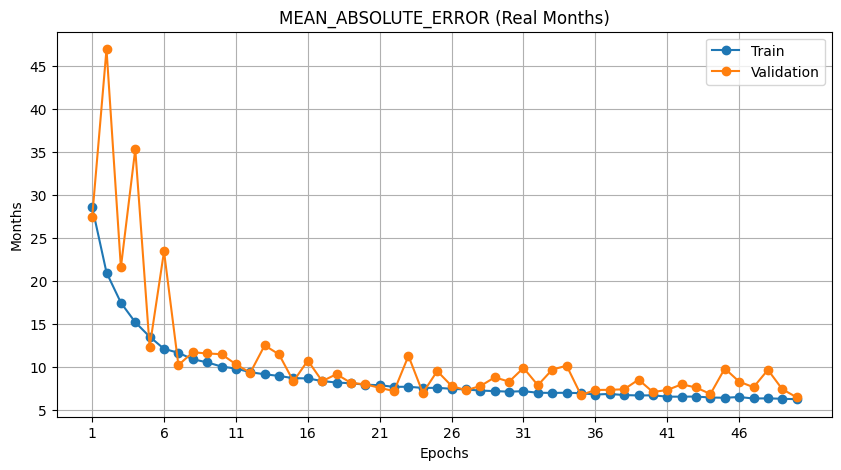

In [31]:
import matplotlib.pyplot as plt
import numpy as np

def plot_history(history, metric, max_age_months=150):
    plt.figure(figsize=(10,5))

    epochs = len(history.history[metric])

    # تحويل للمنطقة الحقيقية
    if metric in ['mean_absolute_error', 'root_mean_squared_error']:
        train_vals = np.array(history.history[metric]) * max_age_months
        val_vals   = np.array(history.history['val_' + metric]) * max_age_months
        plt.ylabel("Months")
    else:
        train_vals = history.history[metric]
        val_vals   = history.history['val_' + metric]
        plt.ylabel(metric)
    
    x_vals = np.arange(1, epochs+1)

    plt.plot(x_vals, train_vals, marker='o', label='Train')
    plt.plot(x_vals, val_vals, marker='o', label='Validation')

    plt.xlabel("Epochs")
    plt.title(f"{metric.upper()} (Real Months)")
    plt.xticks(np.arange(1, epochs+1, 5))
    plt.grid(True)
    plt.legend()
    plt.show()

# رسم MAE الحقيقي للشهور
plot_history(history, 'mean_absolute_error', max_age_months=150)
